# Analog layer function

In [1]:
from concurrent.futures import ThreadPoolExecutor
from typing import List, Tuple
import colorsys
import numpy as np
import matplotlib.pyplot as plt
import sk_dsp_comm.sigsys as ss
# from nptyping import Complex128, Float64, Int64, NDArray, Shape  # type: ignore
from numpy.typing import NDArray
from scipy.signal import find_peaks
import matplotlib.colors as colors
from matplotlib.colors import LinearSegmentedColormap

NP1DF8 = NDArray[np.float64]
NP2DF8 = NDArray[np.float64]
NP1DC16 = NDArray[np.complex128]
NP2DC16 = NDArray[np.complex128]
TT_TYPE = NDArray[np.int64]

def filter_negWaveVectors(M_yx: NP2DC16) -> NP2DC16:
    M_kq = np.fft.fft2(M_yx)
    kLen = int(M_kq.shape[1] / 2 + 1)
    zeros = np.zeros((M_kq.shape[0], kLen))
    M_kq[:, :kLen] = zeros
    M_yx_filtered = np.fft.ifft2(M_kq)
    M_yx_filtered /= np.amax(
        np.abs(M_yx_filtered[:, int(M_yx_filtered.shape[1] / 2 + 100)])
    )
    return M_yx_filtered

def initialize_point_src() -> NP2DC16:
    M_oop = np.load("./point_source_yig/point_source_2600_MHz_200_mT_OOP.npz")["M"]
    pointSrc0 = filter_negWaveVectors(M_oop)
    return pointSrc0[:, int(pointSrc0.shape[1] / 2) :]

def generate_layer_function(
    width: int,
    unit_cell_size: int,
    i: int,
    int_output: NP1DF8,
    phase_1d: NP1DF8,
    amplitude_modulation: bool = False,
    phase_modulation: bool = False,
) -> Tuple[NP1DF8, NP1DF8, NP1DF8, NP1DF8, NP1DF8]:
    width = width // unit_cell_size
    x_int = np.arange(0, width, 1)
    input_amp = np.array(len(x_int)*[1])
    input_phase = 2*np.sin(20 * np.pi * x_int/width)*np.exp(-((x_int-50)/(0.1*width))**2)
    # input_phase = np.zeros_like(x_int)
    if i>0:
        if amplitude_modulation == True and phase_modulation == False:
            input_amp = int_output
            input_phase = np.zeros_like(x_int)
        elif phase_modulation == True and amplitude_modulation == False:
            input_amp = np.array(len(x_int)*[1])
            input_phase = phase_1d
        elif amplitude_modulation == True and phase_modulation == True:
            input_amp = int_output
            input_phase = phase_1d
        else:
            input_amp = np.array(len(x_int)*[1])
            input_phase = np.zeros_like(x_int)
    # layer_func_amp = np.array(len(x_int)*[1])
    layer_func_phase = np.array(len(x_int)*[1])
    layer_func_amp = np.abs(np.sign(x_int - width/2)+1.01)
    
    return input_amp, input_phase, layer_func_amp, layer_func_phase, x_int

def calculate_analytic_signal(
    input_amp: NP1DF8,
    input_phase: NP1DF8,
    layer_func_phase: NP1DF8,
    layer_func_amp: NP1DF8,
    x_int: NP1DF8,
    layer_func_bool: bool,
    i: int
):
    g_in_an = np.zeros_like(x_int, dtype=np.complex128)
    layer_func = np.zeros_like(x_int, dtype=np.complex128)
    
    for jj in range(len(x_int)):
        if i == 0:
            g_in_an[jj] = input_amp[jj-1] * np.exp(1j * input_phase[jj-1])
        elif layer_func_bool == True and i > 0:
            g_in_an[jj] = input_amp[jj-1]*layer_func_amp[jj-1] * np.exp(1j * (input_phase[jj-1]*layer_func_phase[jj-1]))
            layer_func[jj] = layer_func_amp[jj-1]*np.exp(1j*layer_func_phase[jj-1])
        else:
            g_in_an[jj] = input_amp[jj-1] * np.exp(1j * input_phase[jj-1])
    return g_in_an, layer_func

def convolve_column(pointSrc: NP2DC16, g_in: NP1DC16, i: int) -> NP1DC16:
    return np.convolve(pointSrc[:, i], g_in, mode="full")

def convolve_columns(pointSrc: NP2DC16, g_in: NP1DC16) -> NP2DC16:
    newField = np.empty(
        (pointSrc.shape[0] + g_in.shape[0] - 1, pointSrc.shape[1]), dtype=np.complex128
    )
    with ThreadPoolExecutor() as executor:
        futures = [
            executor.submit(convolve_column, pointSrc, g_in, i)
            for i in range(pointSrc.shape[1])
        ]
        for i, future in enumerate(futures):
            newField[:, i] = future.result()
    return newField

def slice_field(
    newField: NP2DC16,
    pointSrc: NP2DC16
) -> NP2DF8:
    newField2 = np.abs(newField[:,:])**2
    newField2 = newField2[
        int(pointSrc.shape[0]/2):-int(pointSrc.shape[0]/2),:
        ]
    return newField2

def colourMode(mod, phase):
    mod = mod/np.amax(mod)
    array1 = np.zeros((phase.shape[0], phase.shape[1], 3))
    for y in range(phase.shape[0]):
        for x in range(phase.shape[1]):
            h = 0.5+phase[y,x]/(2*np.pi)  # angle
            l, s = (mod[y,x]), 1
            array1[y,x] = np.array(colorsys.hls_to_rgb(h, l, s))
    return array1

def logic_oop(
    width: int,  # nm
    unit_cell_size: int,  # nm
    output_line: int,
    number_of_layers: int,
    plots: bool = True,
    one_d_phase: bool = False,
    layer_func_bool: bool = False,
    amplitude_modulation: bool = False,
    phase_modulation: bool = False,
    subsequent_plots: bool = False,
    ):
    intensities = []
    phases =[]
    for j in range(number_of_layers):
        
        axhl = int(output_line // unit_cell_size)
        pointSrc: NP2DC16 = initialize_point_src()
        
        if j == 0:
            int_output = np.zeros(width // unit_cell_size)
            phase_1d = np.zeros(width // unit_cell_size)
            
        input_amp, input_phase, layer_func_amp, layer_func_phase, x_int = generate_layer_function(
            width,
            unit_cell_size,
            j,
            int_output,
            phase_1d,
            amplitude_modulation,
            phase_modulation,
        )        
        
        g_in_c, layer_func = calculate_analytic_signal(
            input_amp,
            input_phase,
            layer_func_phase,
            layer_func_amp,
            x_int,
            layer_func_bool,
            j
        )
        newField: NP2DC16 = convolve_columns(pointSrc, g_in_c)
        intensity: NP2DF8 = slice_field(newField, pointSrc)
        if j == 0:
            max_intensity = np.amax(np.abs(intensity[:,:axhl]))
        intensity /= max_intensity
        int_output: NP1DF8 = intensity[:, axhl]
        phase_2plot = np.angle(newField[int(pointSrc.shape[0] / 2) : -int(pointSrc.shape[0] / 2), : axhl])
        phase_1d: NP1DF8 = phase_2plot[:, -1]
        
        if plots:
            mod_2plot = np.abs(newField[int(pointSrc.shape[0] / 2) : -int(pointSrc.shape[0] / 2), : axhl])
            intentsity_1d_x = np.arange(0, intensity.shape[0], 1)
            phase_1d_x = np.arange(0, intensity.shape[0], 1)
    
            f, ax = plt.subplots(4, 1, figsize=(8, 12))

            ax[0].plot(x_int*unit_cell_size, np.abs(g_in_c), color='k')
            ax[0].fill_between(x_int*unit_cell_size, 0, np.abs(g_in_c), color='#CCCCCC')
            ax[0].set_ylim(0, np.max(np.abs(g_in_c))+0.1*np.max(np.abs(g_in_c)))
            ax[0].set_xlim(0, len(x_int)*unit_cell_size)
            ax[0].set_ylabel("Amplitude")
            ax0a = ax[0].twinx()
            ax0a.plot(x_int*unit_cell_size, np.angle(g_in_c) * 180 / np.pi, color='maroon', ls='-', lw=4)
            ax0a.tick_params(axis='y', labelcolor='maroon')
            ax0a.set_ylabel("Phase (°)", color='maroon')
            ax0a.set_ylim(-190, 190)
            ax0a.set_yticks(range(-180, 190, 90))
            
            ax[1].imshow(colourMode(mod_2plot.T, phase_2plot.T), aspect='auto', interpolation='sinc', 
                         extent=[0, len(intentsity_1d_x)*unit_cell_size, axhl*unit_cell_size, 0]
                         )
            ax[1].set_xlabel("x (nm)")
            ax[1].set_ylabel("y (nm)")
            
            # ax[2].set_ylim(-0.5, 1)
            ax[2].set_ylim(0, np.max(int_output)+0.1*np.max(int_output))
            ax[2].plot(intentsity_1d_x*unit_cell_size, int_output, linewidth=3, color='blue')
            ax[2].fill_between(intentsity_1d_x*unit_cell_size, 0, int_output, color='blue', alpha=0.3)
            ax[2].set_ylabel("Amplitude")
            ax[2].set_xlim(0, len(intentsity_1d_x)*unit_cell_size)
            
            ax[3].imshow(intensity.T[:axhl,:], aspect='auto', extent=[0, len(intentsity_1d_x)*unit_cell_size, axhl*unit_cell_size, 0])
            ax[3].set_xlabel("x (nm)")
            ax[3].set_ylabel("y (nm)")
            
            if one_d_phase:
                ax0b = ax[2].twinx()
                ax0b.plot(phase_1d_x*unit_cell_size, phase_1d * 180 / np.pi, linewidth=2, color='maroon')
                ax0b.set_ylabel("Phase (°)", color='maroon')
                ax0b.set_ylim(-190, 190)
                ax0b.set_yticks(range(-180, 190, 90))
                ax0b.tick_params(axis='y', labelcolor='maroon')
                
            if layer_func_bool and j>0:
                ax0a = ax[2].twinx()
                ax0a.plot(x_int*unit_cell_size, layer_func, color='green', ls='--', lw=2)
                ax0a.tick_params(axis='y', labelcolor='green')
                
                ax0c = ax[0].twinx()
                ax0c.plot(x_int*unit_cell_size, layer_func, color='green', ls='--', lw=2)
                ax0c.plot(x_int*unit_cell_size, layer_func, color='green', ls='--', lw=2)
                ax0c.tick_params(axis='y', labelcolor='green')
            
            plt.tight_layout()
            plt.show() 
                          
        if subsequent_plots:
            mod_2plot = np.abs(newField[int(pointSrc.shape[0] / 2) : -int(pointSrc.shape[0] / 2), : axhl ])
            intentsity_1d_x = np.arange(0, intensity.shape[0], 1)
            phase_1d_x = np.arange(0, intensity.shape[0], 1)
            intensities.append(intensity.T[:axhl,:])
            phases.append(colourMode(mod_2plot.T, phase_2plot.T))
        
    if subsequent_plots:
        f, ax = plt.subplots(number_of_layers, 2, figsize=(15, 12))
        for n in range(number_of_layers):
            ax[n,0].imshow(intensities[n], aspect='auto')
            ax[n,0].axis('off')
            ax[n,1].imshow(phases[n], aspect='auto')
            ax[n,1].axis('off')
            
            if n < number_of_layers - 1:
                ax[n, 0].axhline(y=ax[n, 0].get_ylim()[0], color='black', lw=1)
                ax[n, 1].axhline(y=ax[n, 1].get_ylim()[0], color='black', lw=1)
            
            plt.subplots_adjust(wspace=.1, hspace=0)
            # plt.plot([0.13,0.9], [(n+1)/(number_of_layers-2)-0.5, (n+1)/(number_of_layers-2)-0.5], color='lightgreen', lw=5,transform=plt.gcf().transFigure, clip_on=False)
                

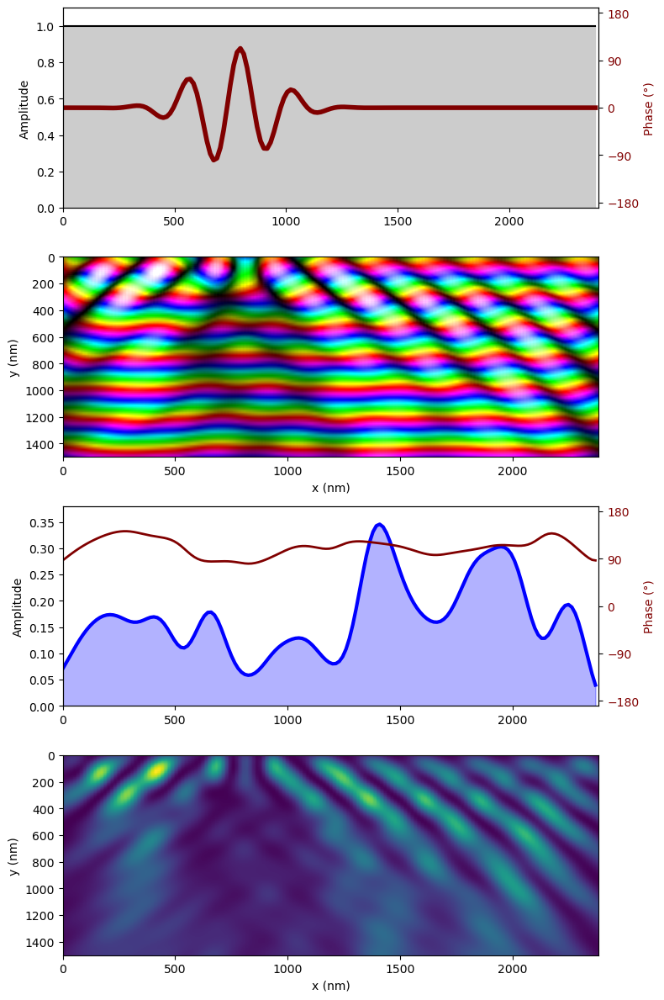

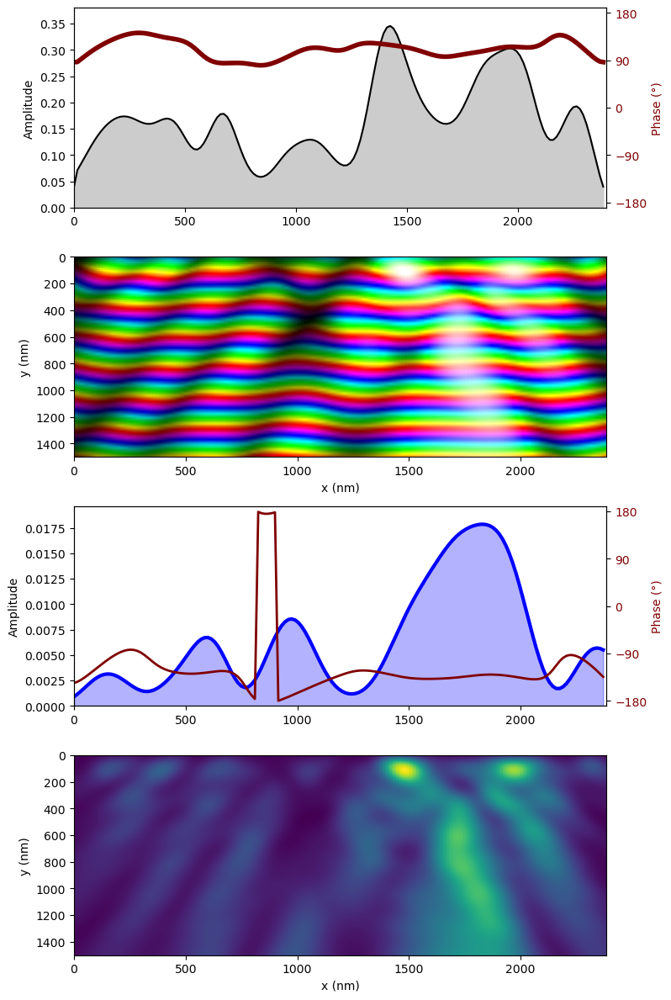

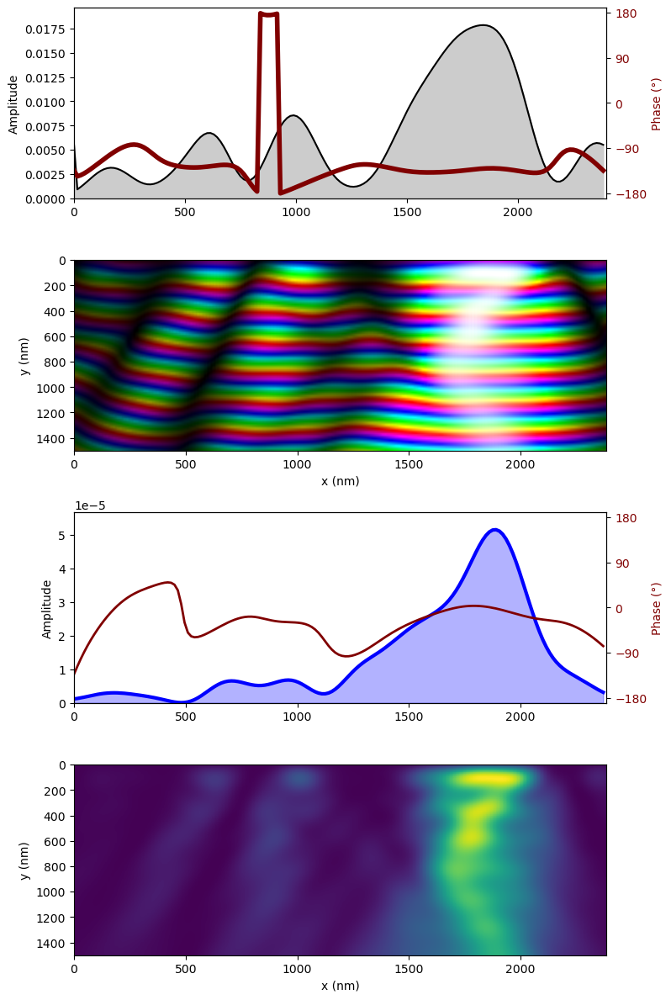

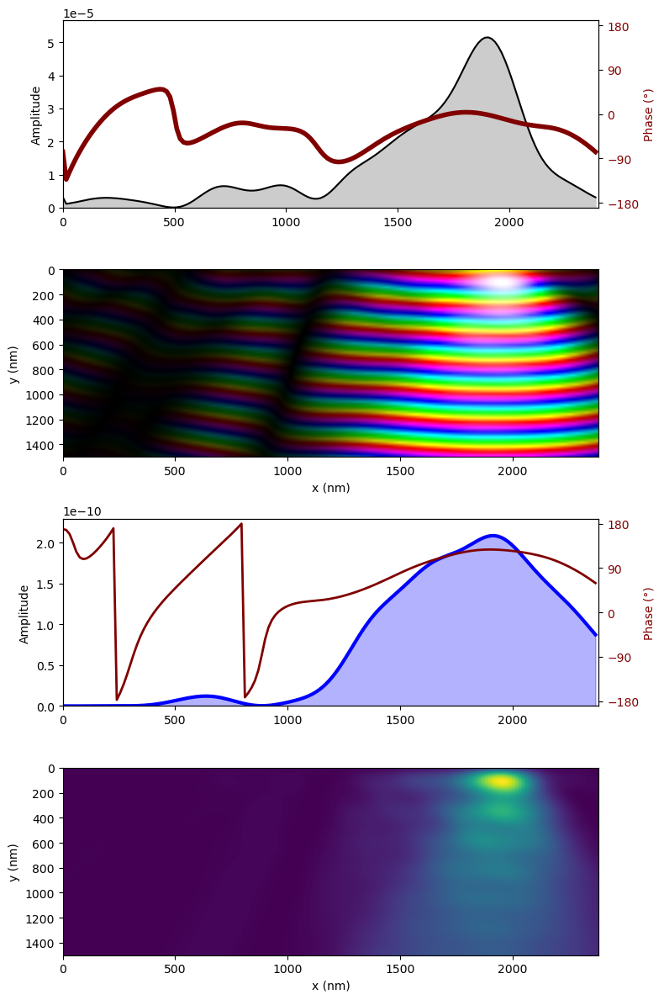

In [4]:
logic_oop(
    width = 2400, # nm
    unit_cell_size = 15, # nm
    output_line = 1500, # nm
    number_of_layers = 4,
    plots = True,
    one_d_phase = True,
    layer_func_bool = False,
    amplitude_modulation = True,
    phase_modulation = True,
    subsequent_plots = False
)

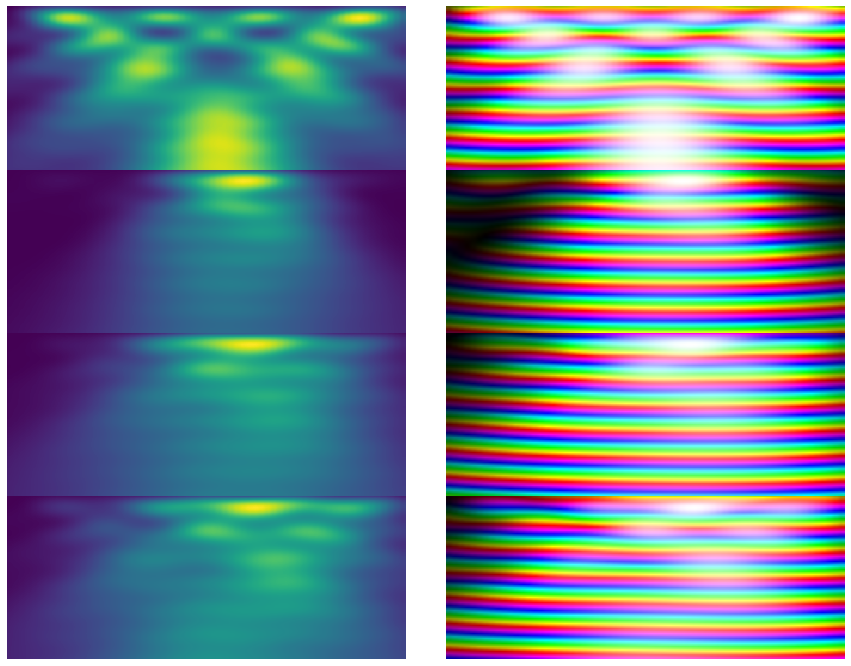

In [5]:
logic_oop(
    width = 1000, # nm
    unit_cell_size = 15, # nm
    output_line = 1500, # nm
    number_of_layers = 4,
    plots = False,
    one_d_phase = True,
    layer_func_bool = False,
    amplitude_modulation = True,
    phase_modulation = True,
    subsequent_plots = True
)

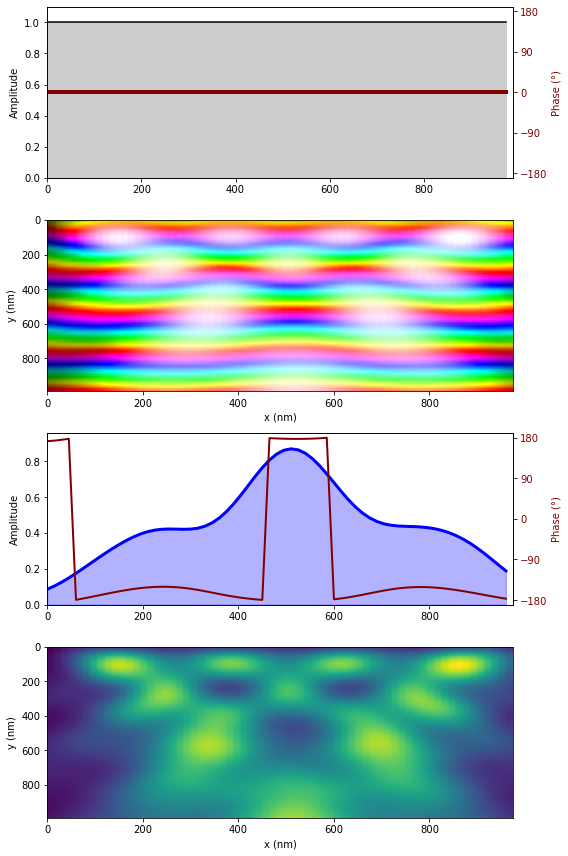

c:\ProgramData\Anaconda3\lib\site-packages\numpy\core\_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
c:\ProgramData\Anaconda3\lib\site-packages\numpy\core\_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
c:\ProgramData\Anaconda3\lib\site-packages\numpy\core\_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


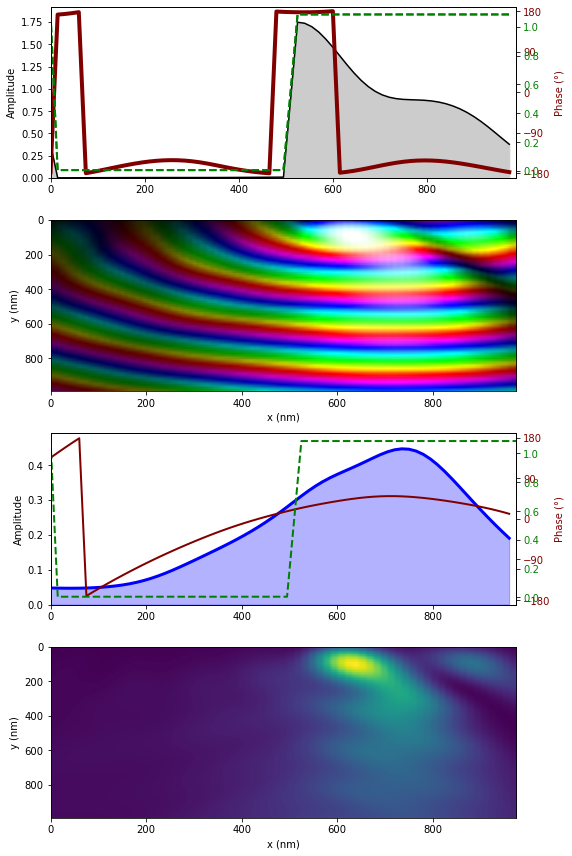

c:\ProgramData\Anaconda3\lib\site-packages\numpy\core\_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
c:\ProgramData\Anaconda3\lib\site-packages\numpy\core\_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
c:\ProgramData\Anaconda3\lib\site-packages\numpy\core\_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


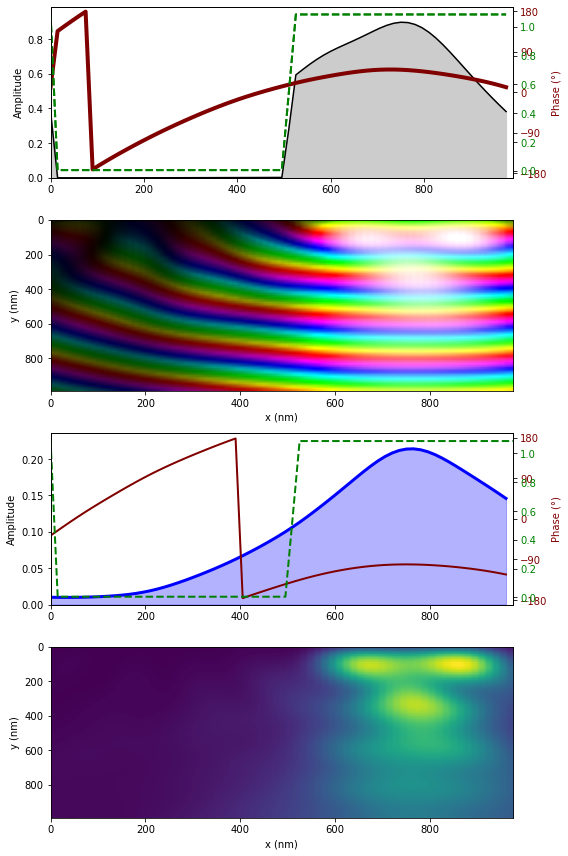

c:\ProgramData\Anaconda3\lib\site-packages\numpy\core\_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
c:\ProgramData\Anaconda3\lib\site-packages\numpy\core\_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
c:\ProgramData\Anaconda3\lib\site-packages\numpy\core\_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


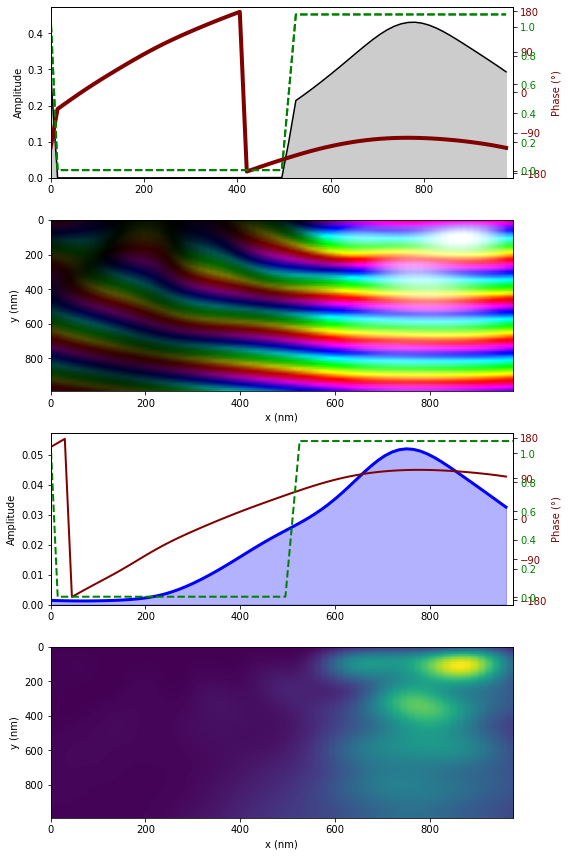

In [6]:
logic_oop(
    width = 1000, # nm
    unit_cell_size = 15, # nm
    output_line = 1000, # nm
    number_of_layers = 4,
    plots = True,
    one_d_phase = True,
    layer_func_bool = True,
    amplitude_modulation = True,
    phase_modulation = True,
    subsequent_plots = False
)

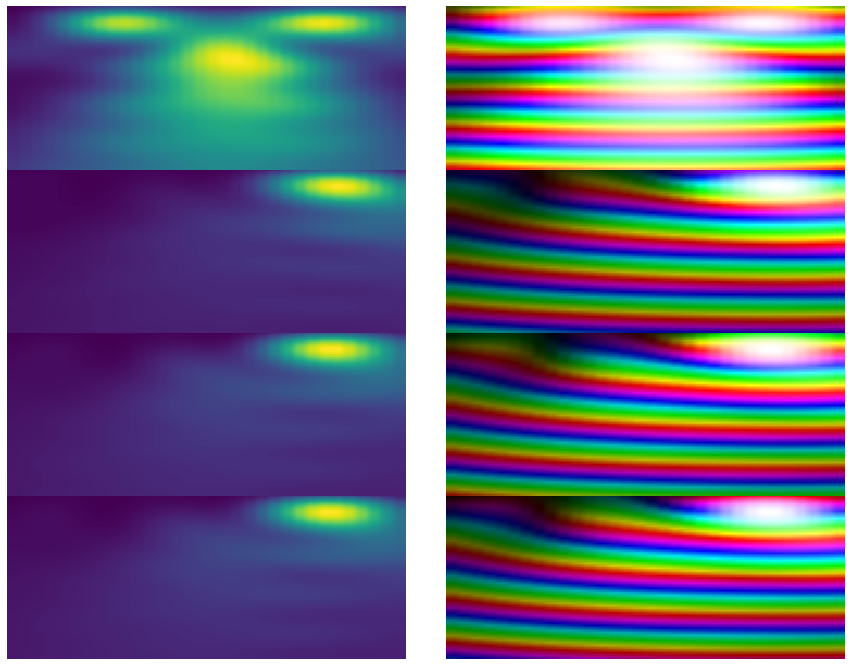

In [8]:
logic_oop(
    width = 500, # nm
    unit_cell_size = 15, # nm
    output_line = 1000, # nm
    number_of_layers = 4,
    plots = False,
    one_d_phase = True,
    layer_func_bool = True,
    amplitude_modulation = True,
    phase_modulation = True,
    subsequent_plots = True
)

# multiple diffraction gratings

In [ ]:
from concurrent.futures import ThreadPoolExecutor
from typing import List, Tuple
import colorsys
import numpy as np
import matplotlib.pyplot as plt
import sk_dsp_comm.sigsys as ss
# from nptyping import Complex128, Float64, Int64, NDArray, Shape  # type: ignore
from numpy.typing import NDArray
from scipy.signal import find_peaks
import matplotlib.colors as colors
from matplotlib.colors import LinearSegmentedColormap

NP1DF8 = NDArray[np.float64]
NP2DF8 = NDArray[np.float64]
NP1DC16 = NDArray[np.complex128]
NP2DC16 = NDArray[np.complex128]
TT_TYPE = NDArray[np.int64]

def filter_negWaveVectors(M_yx: NP2DC16) -> NP2DC16:
    M_kq = np.fft.fft2(M_yx)
    kLen = int(M_kq.shape[1] / 2 + 1)
    zeros = np.zeros((M_kq.shape[0], kLen))
    M_kq[:, :kLen] = zeros
    M_yx_filtered = np.fft.ifft2(M_kq)
    M_yx_filtered /= np.amax(
        np.abs(M_yx_filtered[:, int(M_yx_filtered.shape[1] / 2 + 100)])
    )
    return M_yx_filtered

def initialize_point_src() -> NP2DC16:
    M_oop = np.load("./point_source_yig/point_source_2600_MHz_200_mT_OOP.npz")["M"]
    pointSrc0 = filter_negWaveVectors(M_oop)
    return pointSrc0[:, int(pointSrc0.shape[1] / 2) :]

def generate_layer_function(
    d: int,
    s: int,
    width: int,
    unit_cell_size: int,
    i: int,
    int_output: NP1DF8,
    phase_1d: NP1DF8,
    amplitude_modulation: bool = False,
    phase_modulation: bool = False,
) -> Tuple[NP1DF8, NP1DF8, NP1DF8, NP1DF8, NP1DF8]:
    # width = width // unit_cell_size
    x_int = np.arange(0, width, 1)
    input_amp = ss.rect(np.mod(x_int, d) - d/2, s)
    input_phase = np.array(len(x_int)*[1])
    # input_phase = np.zeros_like(x_int)
    if i>0:
        if amplitude_modulation == True and phase_modulation == False:
            input_amp = int_output
            input_phase = np.zeros_like(x_int)
        elif phase_modulation == True and amplitude_modulation == False:
            input_amp = np.array(len(x_int)*[1])
            input_phase = phase_1d
        elif amplitude_modulation == True and phase_modulation == True:
            input_amp = int_output
            input_phase = phase_1d
        else:
            input_amp = np.array(len(x_int)*[1])
            input_phase = np.zeros_like(x_int)
    # layer_func_amp = np.array(len(x_int)*[1])
    layer_func_phase = np.array(len(x_int)*[1])
    layer_func_amp = ss.rect(np.mod(x_int + (d/2)*i, d) - d/2, 1.5*s)
    
    return input_amp, input_phase, layer_func_amp, layer_func_phase, x_int

def calculate_analytic_signal(
    input_amp: NP1DF8,
    input_phase: NP1DF8,
    layer_func_phase: NP1DF8,
    layer_func_amp: NP1DF8,
    x_int: NP1DF8,
    layer_func_bool: bool,
    i: int
):
    g_in_an = np.zeros_like(x_int, dtype=np.complex128)
    layer_func = np.zeros_like(x_int, dtype=np.complex128)
    
    for jj in range(len(x_int)):
        if i == 0:
            g_in_an[jj] = input_amp[jj-1] * np.exp(1j * input_phase[jj-1])
        elif layer_func_bool == True and i > 0:
            g_in_an[jj] = input_amp[jj-1]*layer_func_amp[jj-1] * np.exp(1j * (input_phase[jj-1]*layer_func_phase[jj-1]))
            layer_func[jj] = layer_func_amp[jj-1]*np.exp(1j*layer_func_phase[jj-1])
        else:
            g_in_an[jj] = input_amp[jj-1] * np.exp(1j * input_phase[jj-1])
    return g_in_an, layer_func

def convolve_column(pointSrc: NP2DC16, g_in: NP1DC16, i: int) -> NP1DC16:
    return np.convolve(pointSrc[:, i], g_in, mode="full")

def convolve_columns(pointSrc: NP2DC16, g_in: NP1DC16) -> NP2DC16:
    newField = np.empty(
        (pointSrc.shape[0] + g_in.shape[0] - 1, pointSrc.shape[1]), dtype=np.complex128
    )
    with ThreadPoolExecutor() as executor:
        futures = [
            executor.submit(convolve_column, pointSrc, g_in, i)
            for i in range(pointSrc.shape[1])
        ]
        for i, future in enumerate(futures):
            newField[:, i] = future.result()
    return newField

def slice_field(
    newField: NP2DC16,
    pointSrc: NP2DC16
) -> NP2DF8:
    newField2 = np.abs(newField[:,:])**2
    newField2 = newField2[
        int(pointSrc.shape[0]/2):-int(pointSrc.shape[0]/2),:
        ]
    return newField2

def colourMode(mod, phase):
    mod = mod/np.amax(mod)
    array1 = np.zeros((phase.shape[0], phase.shape[1], 3))
    for y in range(phase.shape[0]):
        for x in range(phase.shape[1]):
            h = 0.5+phase[y,x]/(2*np.pi)  # angle
            l, s = (mod[y,x]), 1
            array1[y,x] = np.array(colorsys.hls_to_rgb(h, l, s))
    return array1

def logic_oop(
    number_of_inputs: int,
    distance_between_inputs: int,  # nm
    input_width: int,  # nm
    unit_cell_size: int,  # nm
    output_line: int,
    number_of_layers: int,
    plots: bool = True,
    one_d_phase: bool = False,
    layer_func_bool: bool = False,
    amplitude_modulation: bool = False,
    phase_modulation: bool = False,
    subsequent_plots: bool = False,
    ):
    intensities = []
    phases =[]
    
    d = distance_between_inputs // unit_cell_size
    s = input_width // unit_cell_size
    width = d * number_of_inputs
    for j in range(number_of_layers):
        
        axhl = int(output_line // unit_cell_size)
        pointSrc: NP2DC16 = initialize_point_src()
        
        if j == 0:
            int_output = np.zeros(width)
            phase_1d = np.zeros(width)
            
        input_amp, input_phase, layer_func_amp, layer_func_phase, x_int = generate_layer_function(
            d,
            s,
            width,
            unit_cell_size,
            j,
            int_output,
            phase_1d,
            amplitude_modulation,
            phase_modulation,
        )        
        
        g_in_c, layer_func = calculate_analytic_signal(
            input_amp,
            input_phase,
            layer_func_phase,
            layer_func_amp,
            x_int,
            layer_func_bool,
            j
        )
        newField: NP2DC16 = convolve_columns(pointSrc, g_in_c)
        intensity: NP2DF8 = slice_field(newField, pointSrc)
        if j == 0:
            max_intensity = np.amax(np.abs(intensity[:,:axhl]))
        intensity /= max_intensity
        int_output: NP1DF8 = intensity[:, axhl]
        phase_2plot = np.angle(newField[int(pointSrc.shape[0] / 2) : -int(pointSrc.shape[0] / 2), : axhl])
        phase_1d: NP1DF8 = phase_2plot[:, -1]
        
        if plots:
            mod_2plot = np.abs(newField[int(pointSrc.shape[0] / 2) : -int(pointSrc.shape[0] / 2), : axhl])
            intentsity_1d_x = np.arange(0, intensity.shape[0], 1)
            phase_1d_x = np.arange(0, intensity.shape[0], 1)
    
            f, ax = plt.subplots(4, 1, figsize=(8, 12))

            ax[0].plot(x_int*unit_cell_size, np.abs(g_in_c), color='k')
            ax[0].fill_between(x_int*unit_cell_size, 0, np.abs(g_in_c), color='#CCCCCC')
            ax[0].set_ylim(0, np.max(np.abs(g_in_c))+0.1*np.max(np.abs(g_in_c)))
            ax[0].set_xlim(0, len(x_int)*unit_cell_size)
            ax[0].set_ylabel("Amplitude")
            ax0a = ax[0].twinx()
            ax0a.plot(x_int*unit_cell_size, np.angle(g_in_c) * 180 / np.pi, color='maroon', ls='-', lw=4)
            ax0a.tick_params(axis='y', labelcolor='maroon')
            ax0a.set_ylabel("Phase (°)", color='maroon')
            ax0a.set_ylim(-190, 190)
            ax0a.set_yticks(range(-180, 190, 90))
            
            ax[1].imshow(colourMode(mod_2plot.T, phase_2plot.T), aspect='auto', interpolation='sinc', 
                         extent=[0, len(intentsity_1d_x)*unit_cell_size, axhl*unit_cell_size, 0]
                         )
            ax[1].set_xlabel("x (nm)")
            ax[1].set_ylabel("y (nm)")
            
            # ax[2].set_ylim(-0.5, 1)
            ax[2].set_ylim(0, np.max(int_output)+0.1*np.max(int_output))
            ax[2].plot(intentsity_1d_x*unit_cell_size, int_output, linewidth=3, color='blue')
            ax[2].fill_between(intentsity_1d_x*unit_cell_size, 0, int_output, color='blue', alpha=0.3)
            ax[2].set_ylabel("Amplitude")
            ax[2].set_xlim(0, len(intentsity_1d_x)*unit_cell_size)
            
            ax[3].imshow(intensity.T[:axhl,:], aspect='auto', extent=[0, len(intentsity_1d_x)*unit_cell_size, axhl*unit_cell_size, 0])
            ax[3].set_xlabel("x (nm)")
            ax[3].set_ylabel("y (nm)")
            
            if one_d_phase:
                ax0b = ax[2].twinx()
                ax0b.plot(phase_1d_x*unit_cell_size, phase_1d * 180 / np.pi, linewidth=2, color='maroon')
                ax0b.set_ylabel("Phase (°)", color='maroon')
                ax0b.set_ylim(-190, 190)
                ax0b.set_yticks(range(-180, 190, 90))
                ax0b.tick_params(axis='y', labelcolor='maroon')
                
            if layer_func_bool and j>0:
                # ax0a = ax[2].twinx()
                # ax0a.plot(x_int*unit_cell_size, layer_func, color='green', ls='--', lw=2)
                # ax0a.tick_params(axis='y', labelcolor='green')
                
                ax0c = ax[0].twinx()
                ax0c.plot(x_int*unit_cell_size, layer_func, color='green', ls='--', lw=2)
                ax0c.tick_params(axis='y', labelcolor='green')
            
            plt.tight_layout()
            plt.show() 
                          
        if subsequent_plots:
            mod_2plot = np.abs(newField[int(pointSrc.shape[0] / 2) : -int(pointSrc.shape[0] / 2), : axhl ])
            intentsity_1d_x = np.arange(0, intensity.shape[0], 1)
            phase_1d_x = np.arange(0, intensity.shape[0], 1)
            intensities.append(intensity.T[:axhl,:])
            phases.append(colourMode(mod_2plot.T, phase_2plot.T))
        
    if subsequent_plots:
        f, ax = plt.subplots(number_of_layers, 2, figsize=(15, 12))
        for n in range(number_of_layers):
            ax[n,0].imshow(intensities[n], aspect='auto')
            ax[n,0].axis('off')
            ax[n,1].imshow(phases[n], aspect='auto')
            ax[n,1].axis('off')
            
            if n < number_of_layers - 1:
                ax[n, 0].axhline(y=ax[n, 0].get_ylim()[0], color='black', lw=1)
                ax[n, 1].axhline(y=ax[n, 1].get_ylim()[0], color='black', lw=1)
            
            plt.subplots_adjust(wspace=.1, hspace=0)
            # plt.plot([0.13,0.9], [(n+1)/(number_of_layers-2)-0.5, (n+1)/(number_of_layers-2)-0.5], color='lightgreen', lw=5,transform=plt.gcf().transFigure, clip_on=False)
                

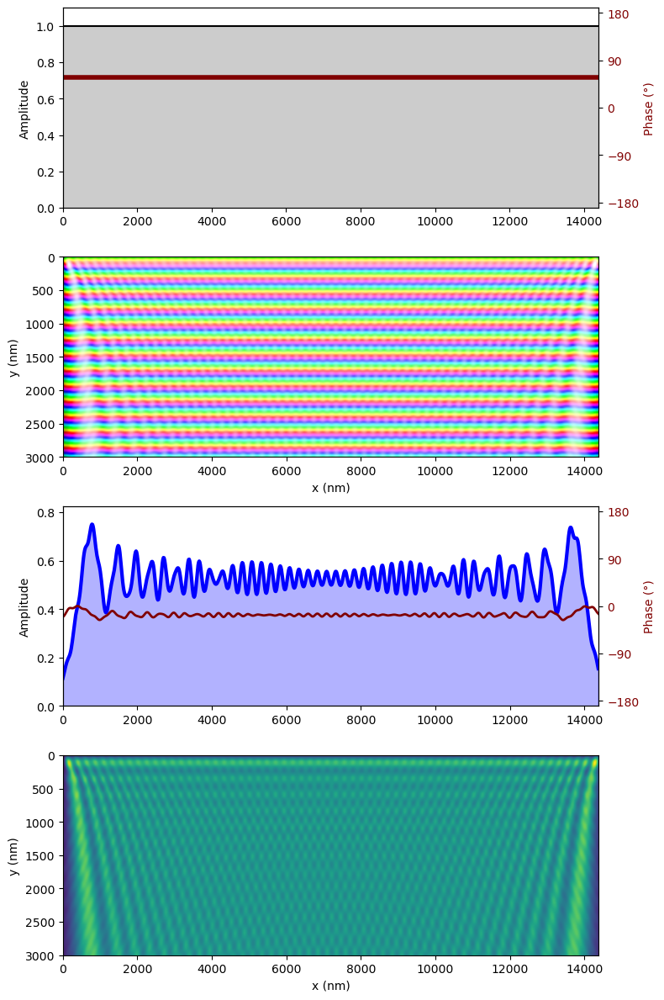

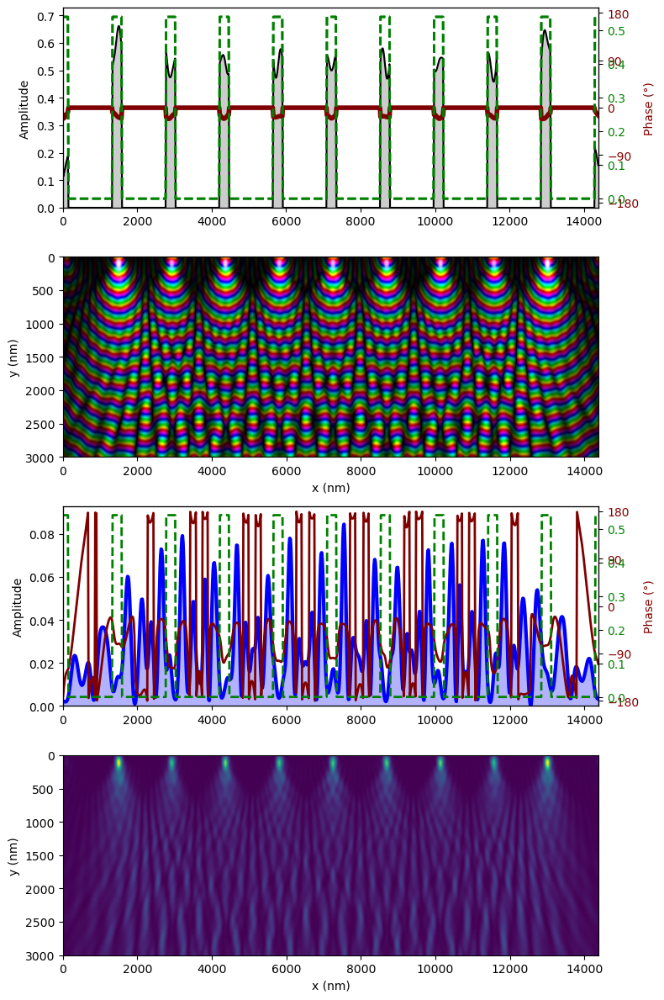

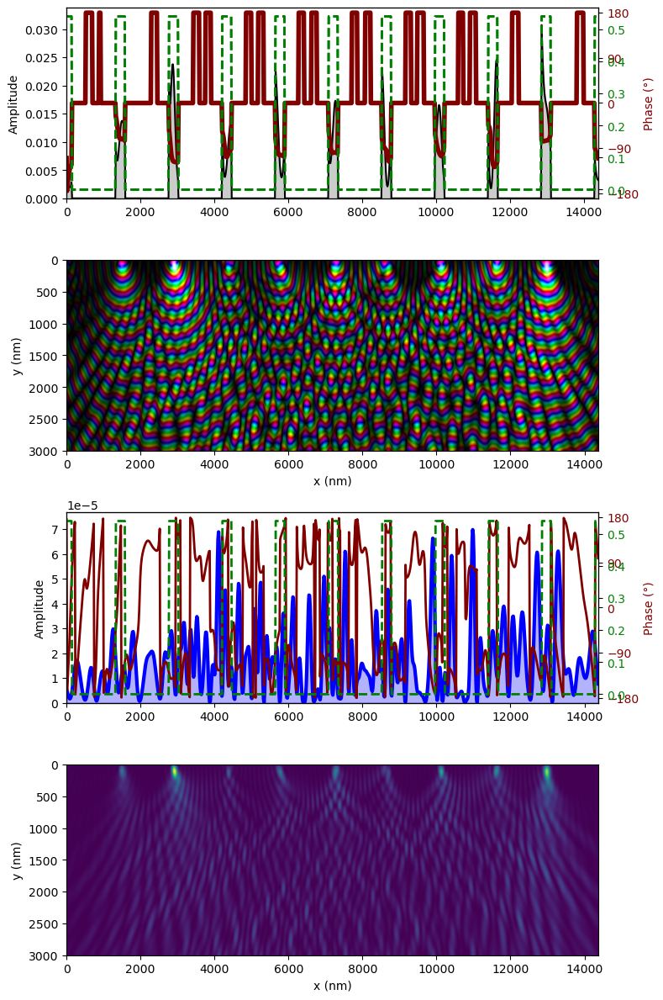

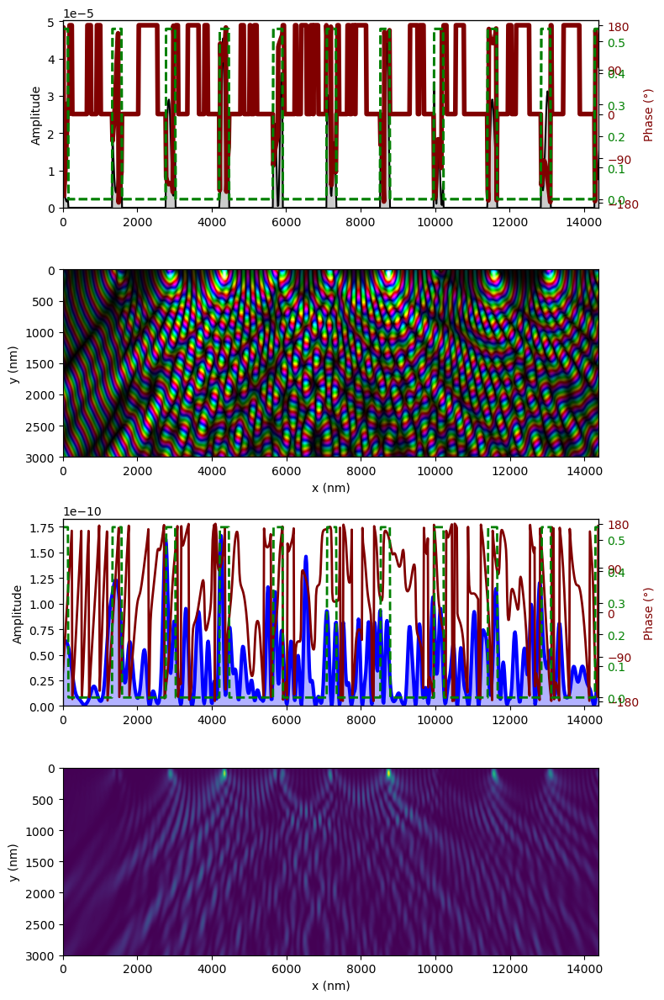

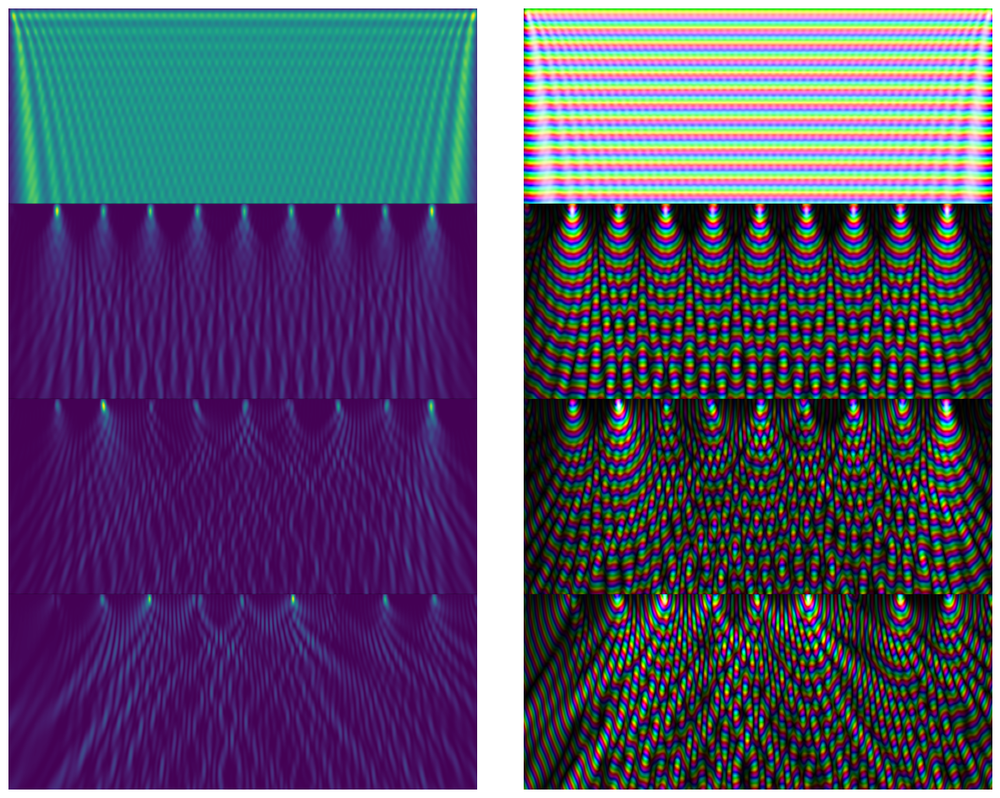

In [52]:
d=1440  # nm
lam = 230.24  # nm
zT = 2*d**2 / lam

logic_oop(
    number_of_inputs=10,
    distance_between_inputs=1440,  # nm
    input_width=240,  # nm
    unit_cell_size = 15, # nm
    output_line = 3000, # nm
    number_of_layers = 4,
    plots = True,
    one_d_phase = True,
    layer_func_bool = True,
    amplitude_modulation = True,
    phase_modulation = True,
    subsequent_plots = True
)

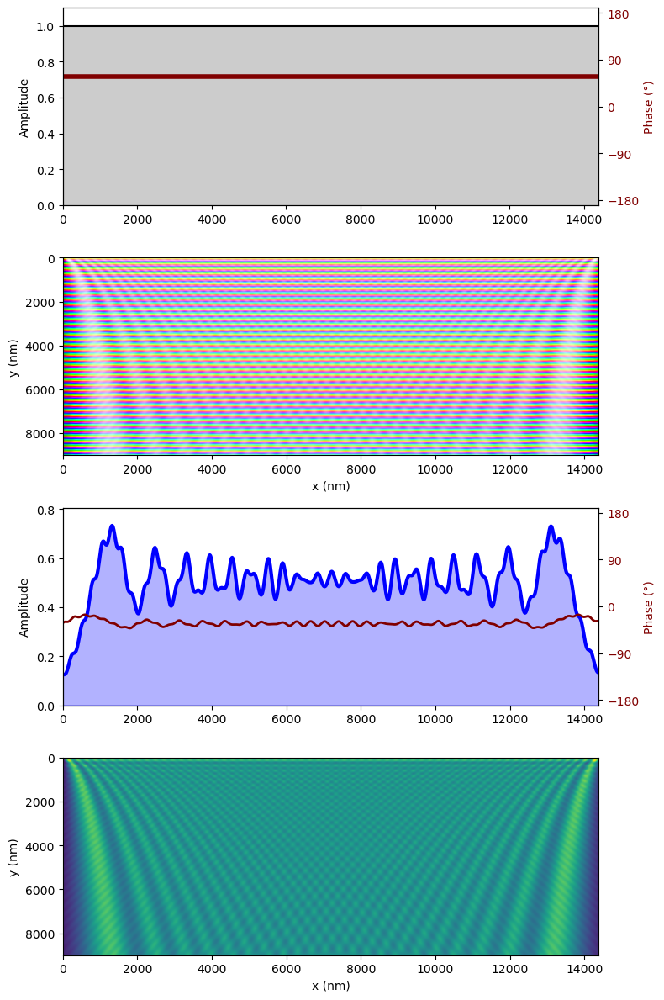

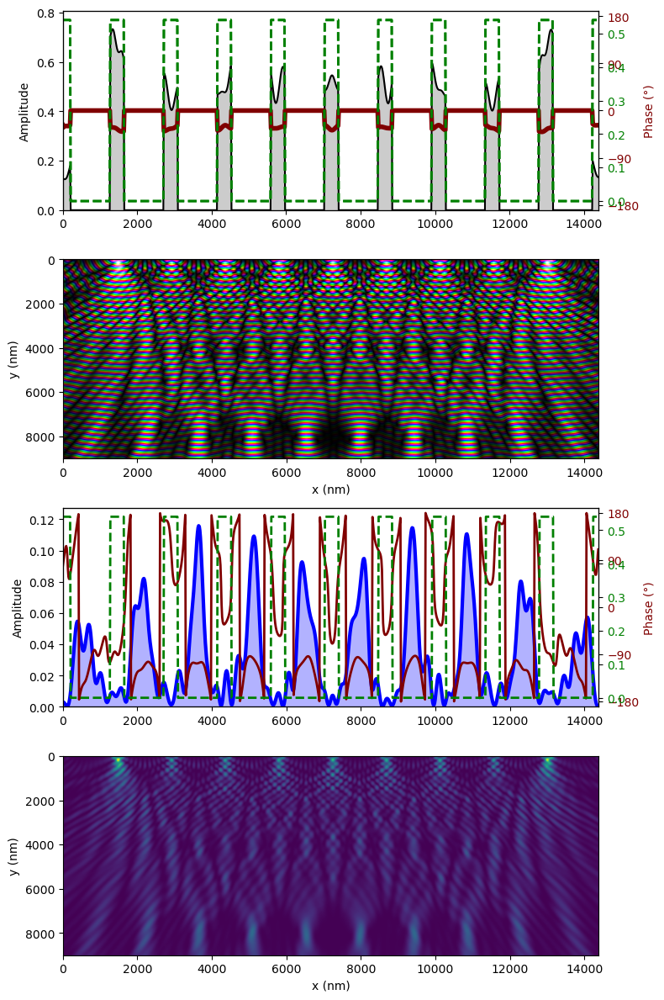

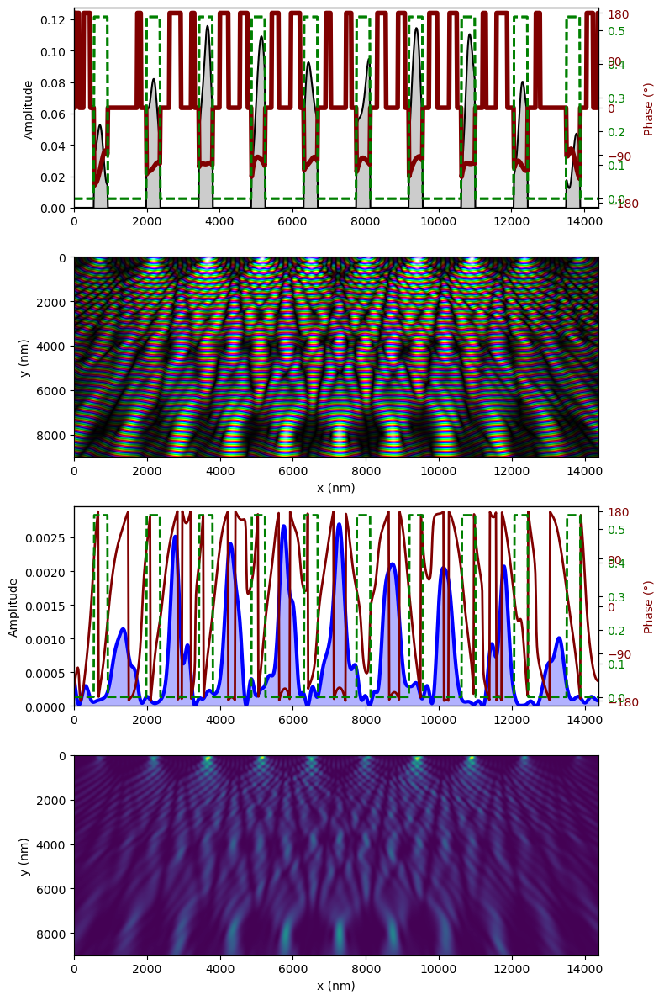

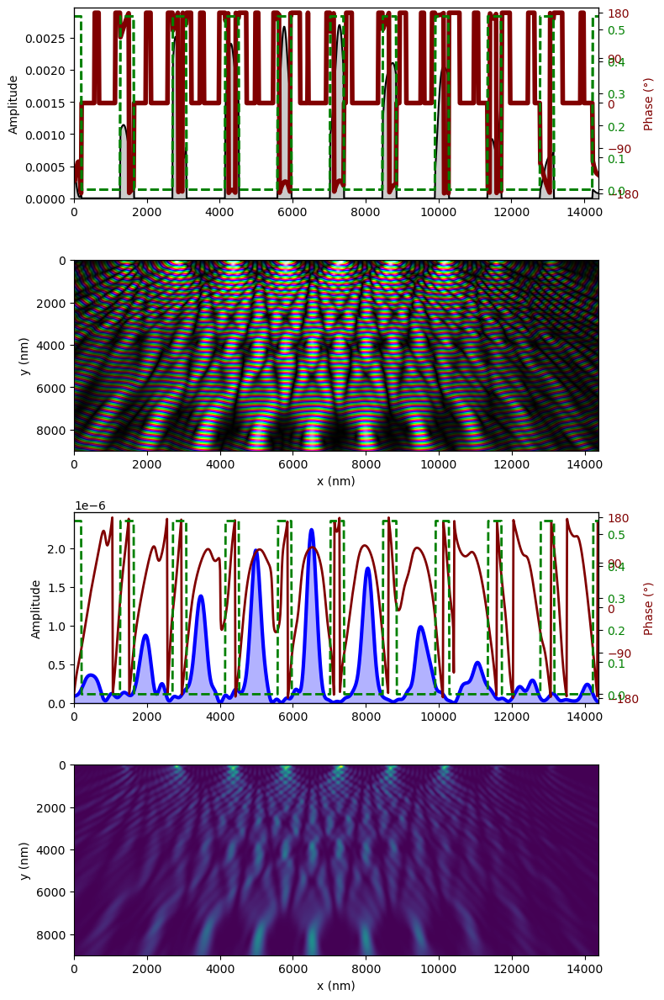

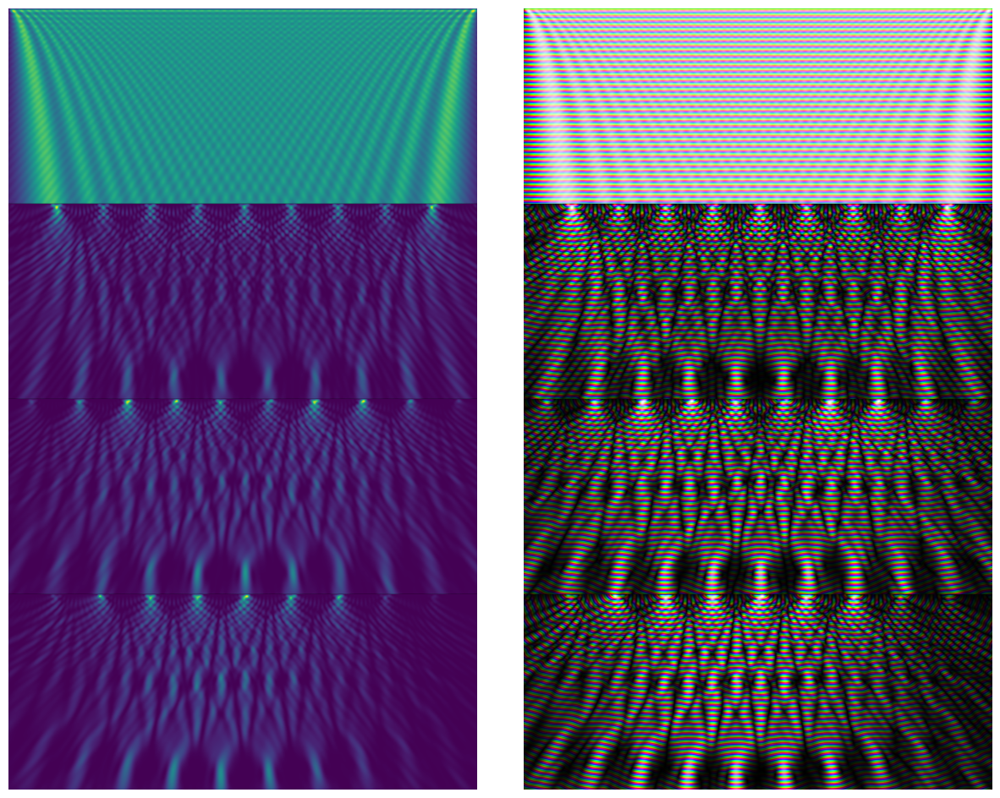

In [62]:
logic_oop(
    number_of_inputs=10,
    distance_between_inputs=1440,  # nm
    input_width=240,  # nm
    unit_cell_size = 15, # nm
    output_line = zT/2, # nm
    number_of_layers = 4,
    plots = True,
    one_d_phase = True,
    layer_func_bool = True,
    amplitude_modulation = True,
    phase_modulation = True,
    subsequent_plots = True
)

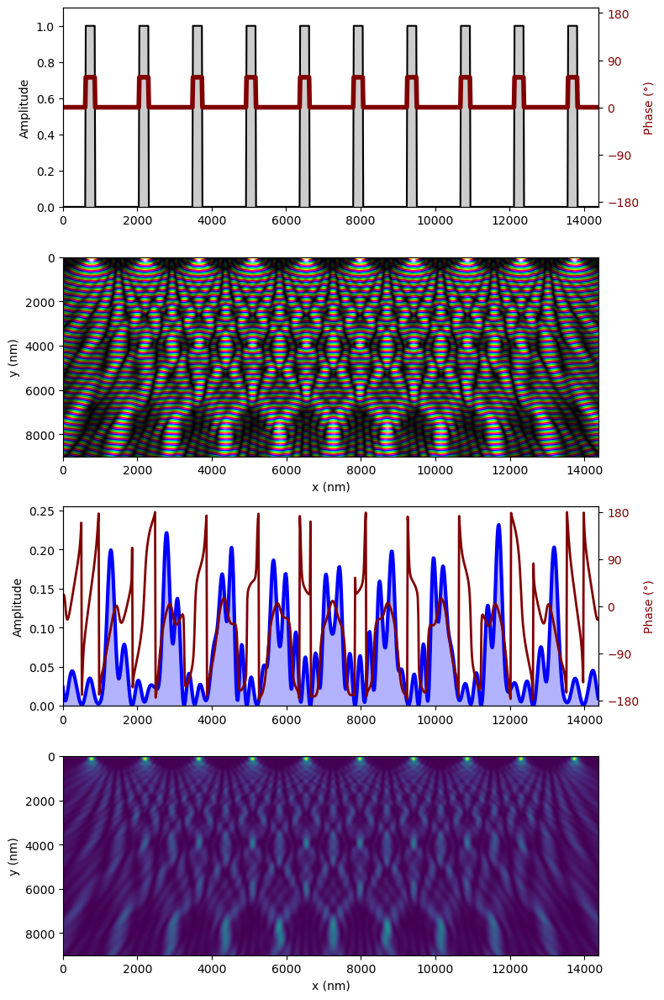

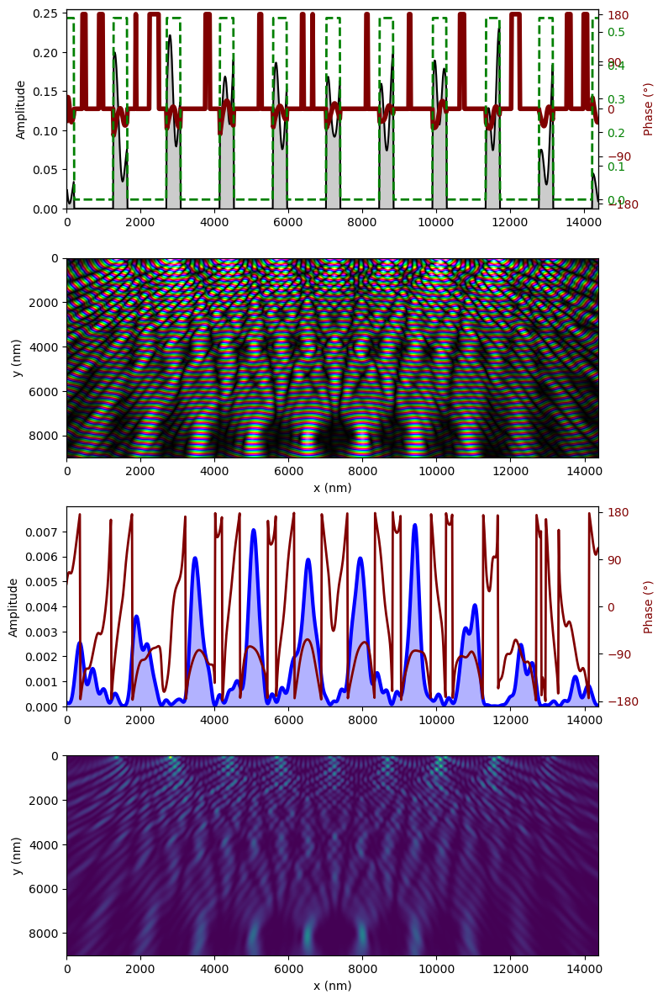

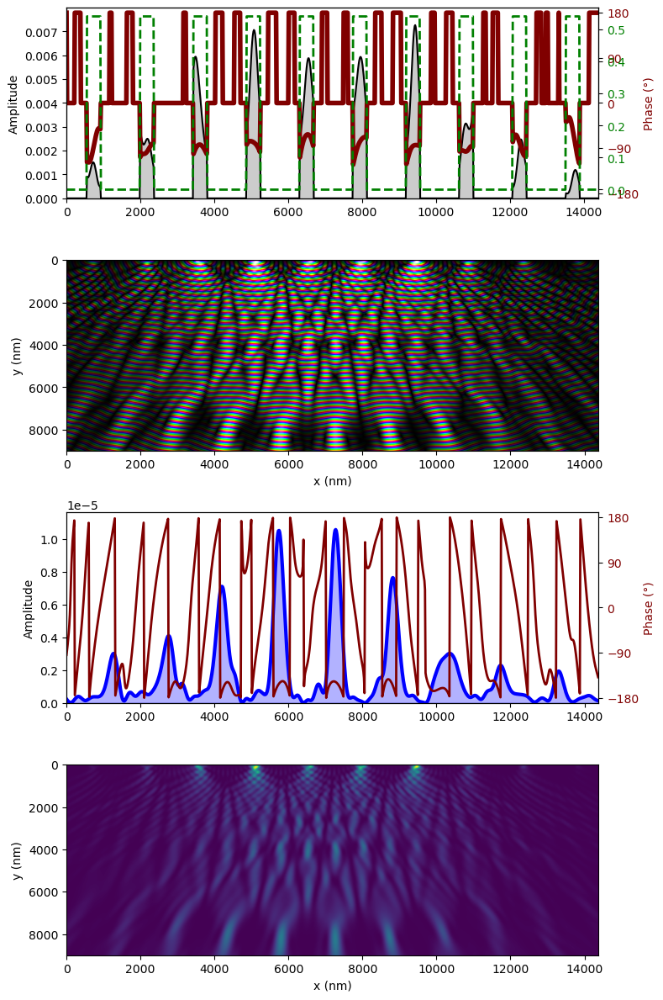

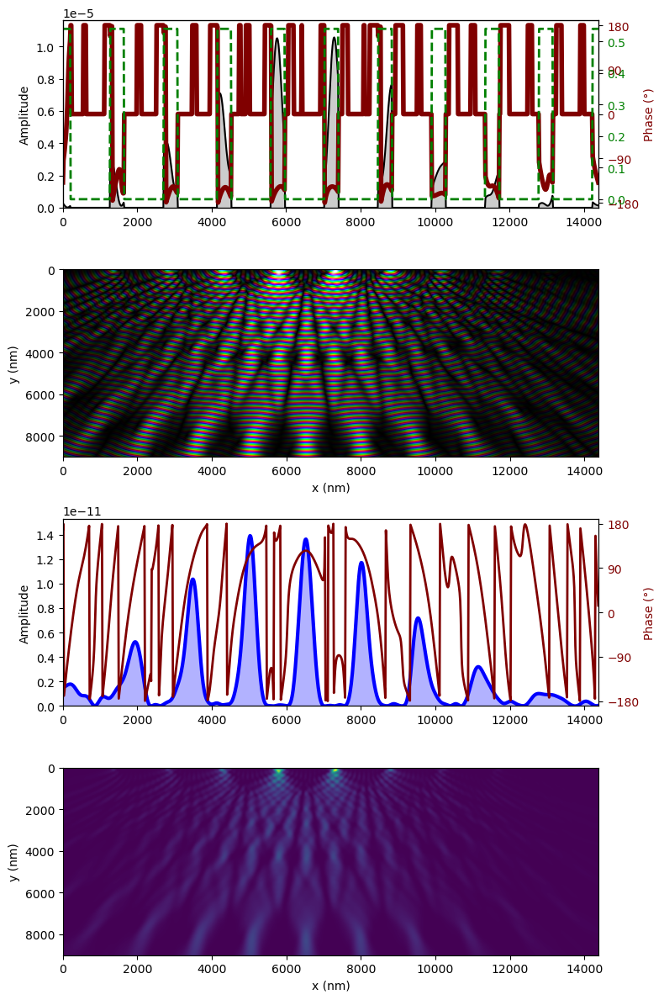

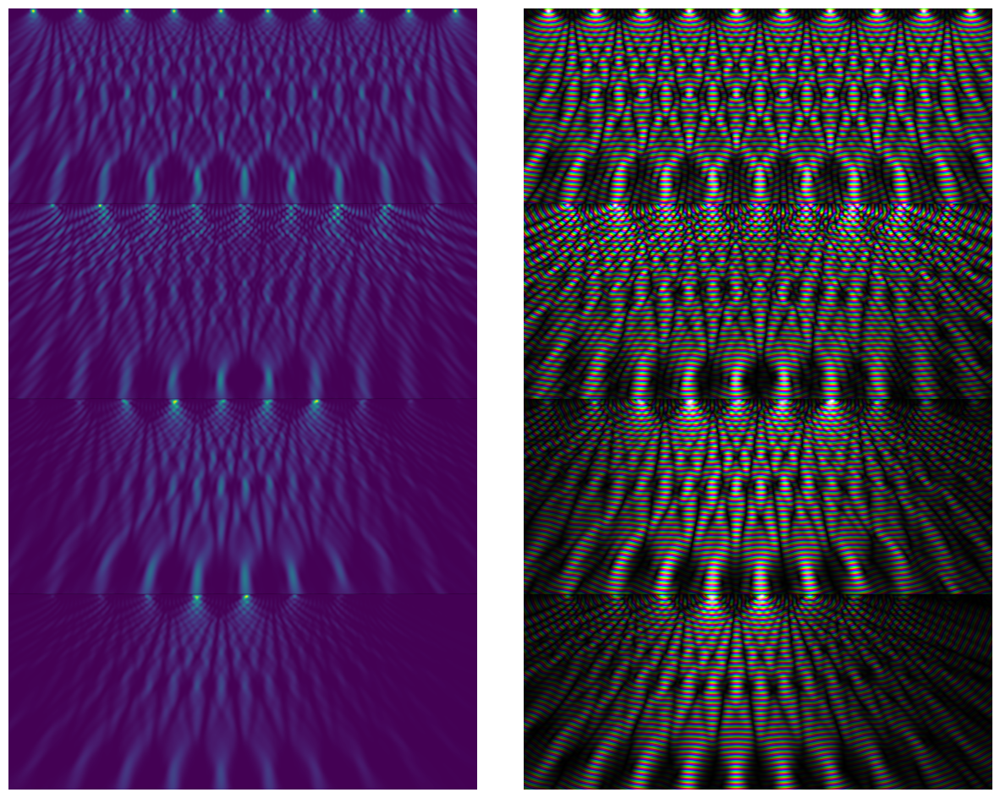

In [67]:
logic_oop(
    number_of_inputs=10,
    distance_between_inputs=1440,  # nm
    input_width=240,  # nm
    unit_cell_size = 15, # nm
    output_line = zT/2, # nm
    number_of_layers = 4,
    plots = True,
    one_d_phase = True,
    layer_func_bool = True,
    amplitude_modulation = True,
    phase_modulation = True,
    subsequent_plots = True
)

In [6]:
d=1440  # nm
lam = 230.24  # nm
zT = 2*d**2 / lam

# for presentation

In [62]:
from concurrent.futures import ThreadPoolExecutor
from typing import List, Tuple
import colorsys
import numpy as np
import matplotlib.pyplot as plt
import sk_dsp_comm.sigsys as ss
# from nptyping import Complex128, Float64, Int64, NDArray, Shape  # type: ignore
from numpy.typing import NDArray
from scipy.signal import find_peaks
import matplotlib.colors as colors
from matplotlib.colors import LinearSegmentedColormap

NP1DF8 = NDArray[np.float64]
NP2DF8 = NDArray[np.float64]
NP1DC16 = NDArray[np.complex128]
NP2DC16 = NDArray[np.complex128]
TT_TYPE = NDArray[np.int64]

def filter_negWaveVectors(M_yx: NP2DC16) -> NP2DC16:
    M_kq = np.fft.fft2(M_yx)
    kLen = int(M_kq.shape[1] / 2 + 1)
    zeros = np.zeros((M_kq.shape[0], kLen))
    M_kq[:, :kLen] = zeros
    M_yx_filtered = np.fft.ifft2(M_kq)
    M_yx_filtered /= np.amax(
        np.abs(M_yx_filtered[:, int(M_yx_filtered.shape[1] / 2 + 100)])
    )
    return M_yx_filtered

def initialize_point_src() -> NP2DC16:
    M_oop = np.load("./point_source_yig/point_source_2600_MHz_200_mT_OOP.npz")["M"]
    pointSrc0 = filter_negWaveVectors(M_oop)
    return pointSrc0[:, int(pointSrc0.shape[1] / 2) :]

def generate_rectangular_function(
    distance_between_inputs: int,
    unit_cell_size: int,
    number_of_inputs: int,
    input_width: int,
    changed_src_numbers: List[int],
    input_phase_shift: float,
    active_input_amplitude: float,
) -> NP1DC16:
    d = distance_between_inputs / unit_cell_size
    s = input_width / unit_cell_size
    width = d * number_of_inputs
    x_int = np.arange(0, width, 1)
    rec = ss.rect(np.mod(x_int, d) - d / 2, s)
    
    
    g_in_an = np.zeros_like(x_int, dtype=complex)
    b = 1
    for i in range(len(x_int)):
        if rec[i] == 1 and (b in changed_src_numbers):
            phi_t = input_phase_shift
            Amp = active_input_amplitude
            if rec[i + 1] == 0:
                b += 1
        elif rec[i] == 1:
            phi_t = 0
            Amp = 1
            if rec[i + 1] == 0:
                b += 1
        else:
            phi_t = 0
            Amp = 1
        g_in_an[i] = Amp * rec[i] * np.exp(1j * phi_t)
    
    return g_in_an

def generate_layer_function(
    d: int,
    s: int,
    width: int,
    unit_cell_size: int,
    i: int,
    rect: NP1DC16,
    int_output: NP1DF8,
    phase_1d: NP1DF8,
    amplitude_modulation: bool = False,
    phase_modulation: bool = False,
) -> Tuple[NP1DF8, NP1DF8, NP1DF8, NP1DF8, NP1DF8]:
    # width = width // unit_cell_size
    x_int = np.arange(0, width, 1)
    input_amp = rect
    input_phase = np.array(len(x_int)*[1])
    # input_phase = np.zeros_like(x_int)
    if i>0:
        if amplitude_modulation == True and phase_modulation == False:
            input_amp = int_output
            input_phase = np.zeros_like(x_int)
        elif phase_modulation == True and amplitude_modulation == False:
            input_amp = np.array(len(x_int)*[1])
            input_phase = phase_1d
        elif amplitude_modulation == True and phase_modulation == True:
            input_amp = int_output
            input_phase = phase_1d
        else:
            input_amp = np.array(len(x_int)*[1])
            input_phase = np.zeros_like(x_int)
    # layer_func_amp = np.array(len(x_int)*[1])
    layer_func_phase = np.array(len(x_int)*[1])
    layer_func_amp = ss.rect(np.mod(x_int + (d/2)*i, d) - d/2, 1.5*s)
    
    return input_amp, input_phase, layer_func_amp, layer_func_phase, x_int

def calculate_analytic_signal(
    input_amp: NP1DF8,
    input_phase: NP1DF8,
    layer_func_phase: NP1DF8,
    layer_func_amp: NP1DF8,
    x_int: NP1DF8,
    layer_func_bool: bool,
    i: int
):
    g_in_an = np.zeros_like(x_int, dtype=np.complex128)
    layer_func = np.zeros_like(x_int, dtype=np.complex128)
    
    for jj in range(len(x_int)):
        if i == 0:
            g_in_an[jj] = input_amp[jj-1] * np.exp(1j * input_phase[jj-1])
        elif layer_func_bool == True and i > 0:
            g_in_an[jj] = input_amp[jj-1]*layer_func_amp[jj-1] 
            # +0* np.exp(1j * (input_phase[jj-1]*layer_func_phase[jj-1]))
            layer_func[jj] = layer_func_amp[jj-1]
            # *np.exp(1j*layer_func_phase[jj-1])
        else:
            g_in_an[jj] = input_amp[jj-1] 
            # * np.exp(1j * input_phase[jj-1])
    return g_in_an, layer_func

def convolve_column(pointSrc: NP2DC16, g_in: NP1DC16, i: int) -> NP1DC16:
    return np.convolve(pointSrc[:, i], g_in, mode="full")

def convolve_columns(pointSrc: NP2DC16, g_in: NP1DC16) -> NP2DC16:
    newField = np.empty(
        (pointSrc.shape[0] + g_in.shape[0] - 1, pointSrc.shape[1]), dtype=np.complex128
    )
    with ThreadPoolExecutor() as executor:
        futures = [
            executor.submit(convolve_column, pointSrc, g_in, i)
            for i in range(pointSrc.shape[1])
        ]
        for i, future in enumerate(futures):
            newField[:, i] = future.result()
    return newField

def slice_field(
    newField: NP2DC16,
    pointSrc: NP2DC16
) -> NP2DF8:
    newField2 = np.real(newField[:,:])
    newField2 = newField2[
        int(pointSrc.shape[0]/2):-int(pointSrc.shape[0]/2),:
        ]
    return newField2

def colourMode(mod, phase):
    mod = mod/np.amax(mod)
    array1 = np.zeros((phase.shape[0], phase.shape[1], 3))
    for y in range(phase.shape[0]):
        for x in range(phase.shape[1]):
            h = 0.5+phase[y,x]/(2*np.pi)  # angle
            l, s = (mod[y,x]), 1
            array1[y,x] = np.array(colorsys.hls_to_rgb(h, l, s))
    return array1

def logic_oop(
    number_of_inputs: int,
    distance_between_inputs: int,  # nm
    input_width: int,  # nm
    unit_cell_size: int,  # nm
    output_line: int,
    number_of_layers: int,
    
    changed_src_numbers: List[int],
    input_phase_shift: float,
    active_input_amplitude: float,
    
    plots: bool = True,
    one_d_phase: bool = False,
    layer_func_bool: bool = False,
    amplitude_modulation: bool = False,
    phase_modulation: bool = False,
    subsequent_plots: bool = False,
    ):
    intensities = []
    phases =[]
    
    d = distance_between_inputs // unit_cell_size
    s = input_width // unit_cell_size
    width = d * number_of_inputs
    for j in range(number_of_layers):
        
        axhl = int(output_line // unit_cell_size)
        pointSrc: NP2DC16 = initialize_point_src()
        
        if j == 0:
            int_output = np.zeros(width)
            phase_1d = np.zeros(width)
            
        rect = generate_rectangular_function(distance_between_inputs, unit_cell_size, number_of_inputs,
                    input_width,
                    changed_src_numbers,
                    input_phase_shift,
                    active_input_amplitude,
                )
            
            
        input_amp, input_phase, layer_func_amp, layer_func_phase, x_int = generate_layer_function(
            d,
            s,
            width,
            unit_cell_size,
            j,
            rect,
            int_output,
            phase_1d,
            amplitude_modulation,
            phase_modulation,
        )        
        
        g_in_c, layer_func = calculate_analytic_signal(
            input_amp,
            input_phase,
            layer_func_phase,
            layer_func_amp,
            x_int,
            layer_func_bool,
            j
        )
        newField: NP2DC16 = convolve_columns(pointSrc, g_in_c)
        intensity: NP2DF8 = slice_field(newField, pointSrc)
        if j == 0:
            max_intensity = np.amax(np.abs(intensity[:,:axhl]))
        intensity /= max_intensity
        int_output: NP1DF8 = intensity[:, axhl]
        phase_2plot = np.angle(newField[int(pointSrc.shape[0] / 2) : -int(pointSrc.shape[0] / 2), : axhl])
        phase_1d: NP1DF8 = phase_2plot[:, -1]
        
        if plots:
            mod_2plot = np.abs(newField[int(pointSrc.shape[0] / 2) : -int(pointSrc.shape[0] / 2), : axhl])
            intentsity_1d_x = np.arange(0, intensity.shape[0], 1)
            phase_1d_x = np.arange(0, intensity.shape[0], 1)
    
            f, ax = plt.subplots(4, 1, figsize=(8, 12))

            ax[0].plot(x_int*unit_cell_size, np.abs(g_in_c), color='k')
            ax[0].fill_between(x_int*unit_cell_size, 0, np.abs(g_in_c), color='#CCCCCC')
            ax[0].set_ylim(0, np.max(np.abs(g_in_c))+0.1*np.max(np.abs(g_in_c)))
            ax[0].set_xlim(0, len(x_int)*unit_cell_size)
            ax[0].set_ylabel("Amplitude")
            ax0a = ax[0].twinx()
            ax0a.plot(x_int*unit_cell_size, np.angle(g_in_c) * 180 / np.pi, color='maroon', ls='-', lw=4)
            ax0a.tick_params(axis='y', labelcolor='maroon')
            ax0a.set_ylabel("Phase (°)", color='maroon')
            ax0a.set_ylim(-190, 190)
            ax0a.set_yticks(range(-180, 190, 90))
            
            ax[1].imshow(colourMode(mod_2plot.T, phase_2plot.T), aspect='auto', interpolation='sinc', 
                         extent=[0, len(intentsity_1d_x)*unit_cell_size, axhl*unit_cell_size, 0]
                         )
            ax[1].set_xlabel("x (nm)")
            ax[1].set_ylabel("y (nm)")
            
            # ax[2].set_ylim(-0.5, 1)
            # ax[2].set_ylim(0, np.max(int_output)+0.1*np.max(int_output))
            ax[2].plot(intentsity_1d_x*unit_cell_size, int_output, linewidth=3, color='blue')
            ax[2].fill_between(intentsity_1d_x*unit_cell_size, 0, int_output, color='blue', alpha=0.3)
            ax[2].set_ylabel("Amplitude")
            ax[2].set_xlim(0, len(intentsity_1d_x)*unit_cell_size)
            
            ax[3].imshow(intensity.T[:axhl,:], aspect='auto', extent=[0, len(intentsity_1d_x)*unit_cell_size, axhl*unit_cell_size, 0], cmap='bwr')
            ax[3].set_xlabel("x (nm)")
            ax[3].set_ylabel("y (nm)")
            
            if one_d_phase:
                ax0b = ax[2].twinx()
                ax0b.plot(phase_1d_x*unit_cell_size, phase_1d * 180 / np.pi, linewidth=2, color='maroon')
                ax0b.set_ylabel("Phase (°)", color='maroon')
                ax0b.set_ylim(-190, 190)
                ax0b.set_yticks(range(-180, 190, 90))
                ax0b.tick_params(axis='y', labelcolor='maroon')
                
            if layer_func_bool and j>0:
                # ax0a = ax[2].twinx()
                # ax0a.plot(x_int*unit_cell_size, layer_func, color='green', ls='--', lw=2)
                # ax0a.tick_params(axis='y', labelcolor='green')
                
                ax0c = ax[0].twinx()
                ax0c.plot(x_int*unit_cell_size, layer_func, color='green', ls='--', lw=2)
                ax0c.tick_params(axis='y', labelcolor='green')
            
            plt.tight_layout()
            plt.show() 
                          
        if subsequent_plots:
            mod_2plot = np.abs(newField[int(pointSrc.shape[0] / 2) : -int(pointSrc.shape[0] / 2), : axhl ])
            intentsity_1d_x = np.arange(0, intensity.shape[0], 1)
            phase_1d_x = np.arange(0, intensity.shape[0], 1)
            intensities.append(intensity.T[:axhl,:])
            phases.append(colourMode(mod_2plot.T, phase_2plot.T))
        
    if subsequent_plots:
        f, ax = plt.subplots(number_of_layers, 2, figsize=(15, 12))
        for n in range(number_of_layers):
            ax[n,0].imshow(intensities[n], aspect='equal', cmap='bwr')
            ax[n,0].axis('off')
            ax[n,1].imshow(phases[n], aspect='equal')
            ax[n,1].axis('off')
            
            if n < number_of_layers - 1:
                ax[n, 0].axhline(y=ax[n, 0].get_ylim()[0], color='black', lw=1)
                ax[n, 1].axhline(y=ax[n, 1].get_ylim()[0], color='black', lw=1)
            
            plt.subplots_adjust(wspace=.1, hspace=0)
            # plt.plot([0.13,0.9], [(n+1)/(number_of_layers-2)-0.5, (n+1)/(number_of_layers-2)-0.5], color='lightgreen', lw=5,transform=plt.gcf().transFigure, clip_on=False)
                

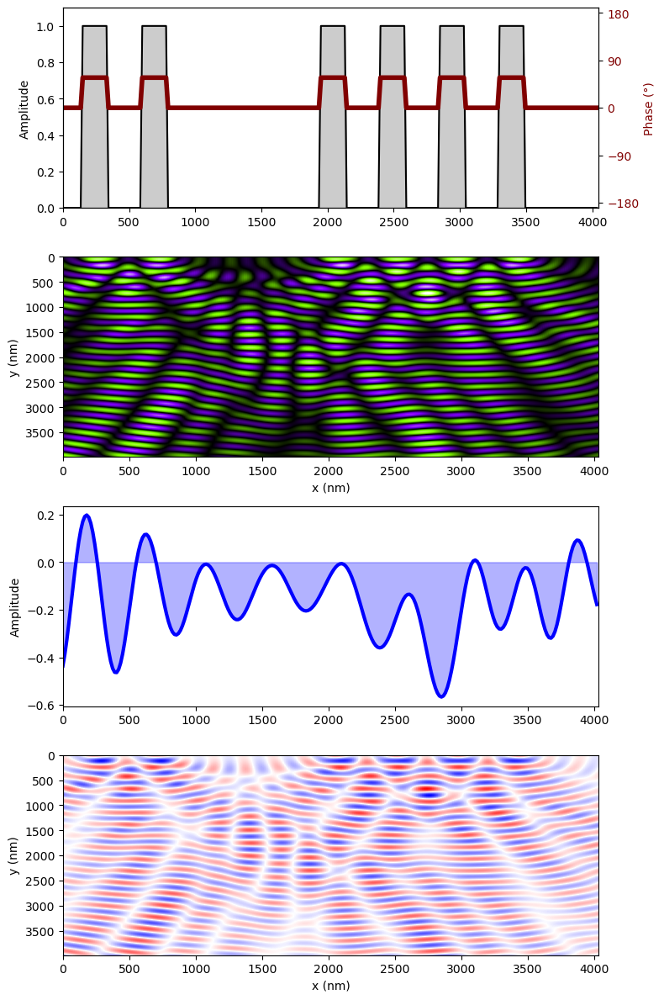

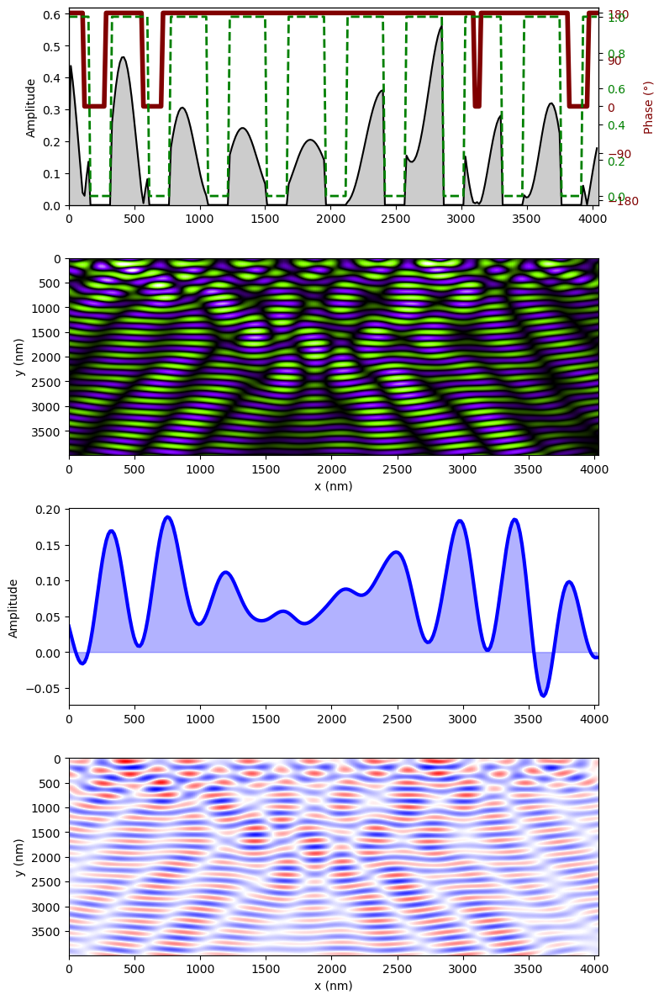

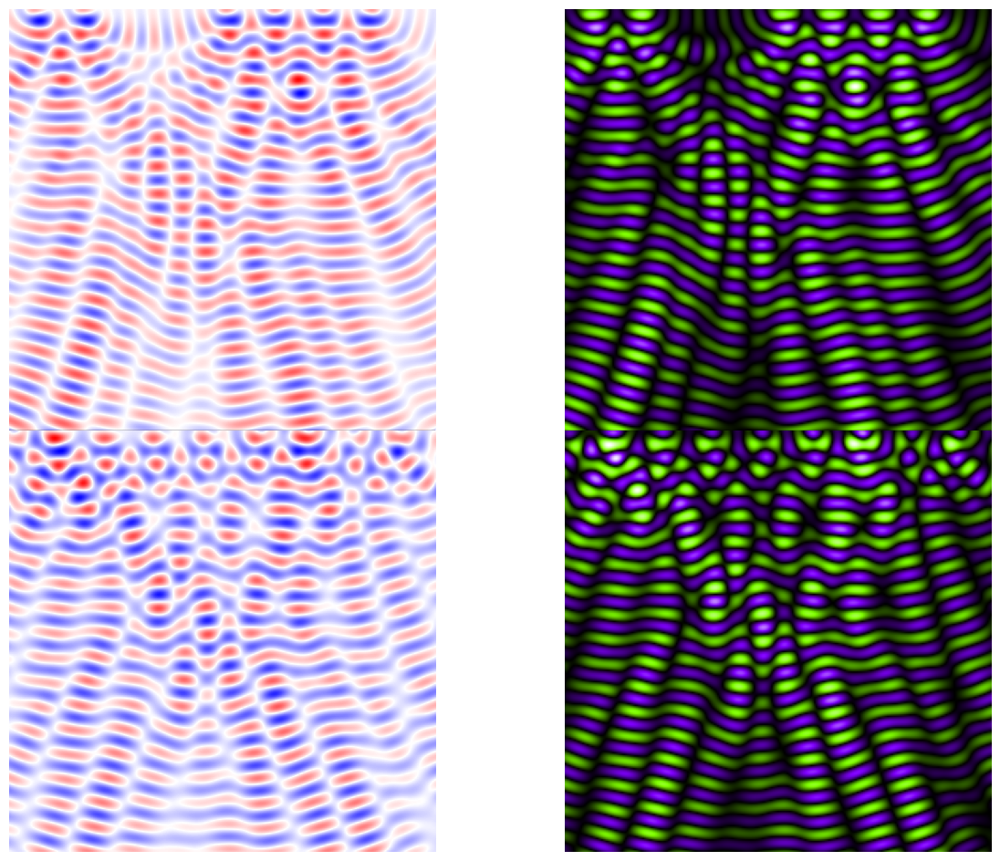

In [63]:
logic_oop(
    number_of_inputs = 9,
    distance_between_inputs= 450,  # nm
    input_width=195,  # nm
    unit_cell_size = 15, # nm
    output_line = 4000, # nm
    number_of_layers = 2,
    changed_src_numbers = [3,4,9],
    input_phase_shift = np.pi/2,
    active_input_amplitude = 0,
    plots = True,
    one_d_phase = False,
    layer_func_bool = True,
    amplitude_modulation = True,
    phase_modulation = False,
    subsequent_plots = True
)